In [2]:
pip install lazypredict

In [3]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 7.0 MB/s eta 0:00:00


In [1]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=6bcf8437de0c347d8b88b75a24feca8a82cb9ed2023c210f0762bf5972a1ebdb
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [4]:
pip install dalex

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 8.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for dalex: filename=dalex-1.7.0-py3-none-any.whl size=1042471 sha256=a0a4eeb8615489db680f1ee4fd2042e01575c2bd5ff4695accf65fe007fdb232
  Stored in directory: /root/.cache/pip/wheels/e2/38/c1/25a95206a4873a287d776fc8e77aa7d93971acc643ecb3db38
Successfully built dalex


In [6]:
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
sns.set_theme(style='whitegrid')
import re
import calendar
# Set display options to show all columns
pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows',None)
# Ignore all warnings
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import lightgbm as lgb
from sklearn.metrics import log_loss
from sklearn.metrics import make_scorer

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import LabelEncoder
from xgboost import plot_importance

from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.model_selection import RandomizedSearchCV, train_test_split, StratifiedKFold, cross_val_score
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import VotingClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression

from xgboost import XGBClassifier
import xgboost as xgb
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier

from scipy.stats import randint, uniform

from lazypredict.Supervised import LazyClassifier, accuracy_score
from sklearn.cluster import KMeans
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import log_loss
from sklearn.model_selection import KFold
import shap
import lime
import lime.lime_tabular
import dalex as dx

In [7]:
df_data = pd.read_csv("cirrhosis.csv")

In [8]:
df_data.head()

,ID,N_Days,Status,Drug,Age,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
0,1,400,D,D-penicillamine,21464,F,Y,Y,Y,Y,14.50,261.00,2.60,156.00,1718.00,137.95,172.00,190.00,12.20,4.00
1,2,4500,C,D-penicillamine,20617,F,N,Y,Y,N,1.10,302.00,4.14,54.00,7394.80,113.52,88.00,221.00,10.60,3.00
2,3,1012,D,D-penicillamine,25594,M,N,N,N,S,1.40,176.00,3.48,210.00,516.00,96.10,55.00,151.00,12.00,4.00
3,4,1925,D,D-penicillamine,19994,F,N,Y,Y,S,1.80,244.00,2.54,64.00,6121.80,60.63,92.00,183.00,10.30,4.00
4,5,1504,CL,Placebo,13918,F,N,Y,Y,N,3.40,279.00,3.53,143.00,671.00,113.15,72.00,136.00,10.90,3.00


In [9]:
def diagnose_dataframe(df, verbose=True):
    """
    Performs various initial inspections on a pandas dataframe and provides details.

    Args:
      df: The pandas dataframe to diagnose.
      verbose: Whether to print details for each inspection.

    Returns:
      A dictionary containing the results of the inspections.
    """

    results = {}

    # Basic information
    results["shape"] = df.shape
    results["columns"] = list(df.columns)
    results["dtypes"] = df.dtypes.to_dict()

    # Check for disparities between dtypes and actual values
    dtypes_disparities = {}
    for col in df.columns:
        unique_values = df[col].unique()
        dtype = df[col].dtype
        unique_types = set(type(value).__name__ for value in unique_values)
        if len(unique_types) > 1:
            dtypes_disparities[col] = {"dtype": dtype, "unique_types": list(unique_types)}

    results["dtypes_disparities"] = dtypes_disparities

    # Unique values and counts
    for col in df.columns:
        results[f"unique_values_{col}"] = df[col].unique()

    if verbose:
        for key, value in results.items():
            print(f"\n{key}:\n{value}")

    return results

In [10]:
diagnose_dataframe(df_data)


shape:
(418, 20)

columns:
['ID', 'N_Days', 'Status', 'Drug', 'Age', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema', 'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage']

dtypes:
{'ID': dtype('int64'), 'N_Days': dtype('int64'), 'Status': dtype('O'), 'Drug': dtype('O'), 'Age': dtype('int64'), 'Sex': dtype('O'), 'Ascites': dtype('O'), 'Hepatomegaly': dtype('O'), 'Spiders': dtype('O'), 'Edema': dtype('O'), 'Bilirubin': dtype('float64'), 'Cholesterol': dtype('float64'), 'Albumin': dtype('float64'), 'Copper': dtype('float64'), 'Alk_Phos': dtype('float64'), 'SGOT': dtype('float64'), 'Tryglicerides': dtype('float64'), 'Platelets': dtype('float64'), 'Prothrombin': dtype('float64'), 'Stage': dtype('float64')}

dtypes_disparities:
{'Drug': {'dtype': dtype('O'), 'unique_types': ['float', 'str']}, 'Ascites': {'dtype': dtype('O'), 'unique_types': ['float', 'str']}, 'Hepatomegaly': {'dtype': dtype('O'), 'unique_types': ['fl

{'shape': (418, 20),
 'columns': ['ID',
  'N_Days',
  'Status',
  'Drug',
  'Age',
  'Sex',
  'Ascites',
  'Hepatomegaly',
  'Spiders',
  'Edema',
  'Bilirubin',
  'Cholesterol',
  'Albumin',
  'Copper',
  'Alk_Phos',
  'SGOT',
  'Tryglicerides',
  'Platelets',
  'Prothrombin',
  'Stage'],
 'dtypes': {'ID': dtype('int64'),
  'N_Days': dtype('int64'),
  'Status': dtype('O'),
  'Drug': dtype('O'),
  'Age': dtype('int64'),
  'Sex': dtype('O'),
  'Ascites': dtype('O'),
  'Hepatomegaly': dtype('O'),
  'Spiders': dtype('O'),
  'Edema': dtype('O'),
  'Bilirubin': dtype('float64'),
  'Cholesterol': dtype('float64'),
  'Albumin': dtype('float64'),
  'Copper': dtype('float64'),
  'Alk_Phos': dtype('float64'),
  'SGOT': dtype('float64'),
  'Tryglicerides': dtype('float64'),
  'Platelets': dtype('float64'),
  'Prothrombin': dtype('float64'),
  'Stage': dtype('float64')},
 'dtypes_disparities': {'Drug': {'dtype': dtype('O'),
   'unique_types': ['float', 'str']},
  'Ascites': {'dtype': dtype('O'), '

In [11]:
df_data.columns

Index(['ID', 'N_Days', 'Status', 'Drug', 'Age', 'Sex', 'Ascites',
       'Hepatomegaly', 'Spiders', 'Edema', 'Bilirubin', 'Cholesterol',
       'Albumin', 'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets',
       'Prothrombin', 'Stage'],
      dtype='object')

In [12]:
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 418 entries, 0 to 417
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   ID             418 non-null    int64  
 1   N_Days         418 non-null    int64  
 2   Status         418 non-null    object 
 3   Drug           312 non-null    object 
 4   Age            418 non-null    int64  
 5   Sex            418 non-null    object 
 6   Ascites        312 non-null    object 
 7   Hepatomegaly   312 non-null    object 
 8   Spiders        312 non-null    object 
 9   Edema          418 non-null    object 
 10  Bilirubin      418 non-null    float64
 11  Cholesterol    284 non-null    float64
 12  Albumin        418 non-null    float64
 13  Copper         310 non-null    float64
 14  Alk_Phos       312 non-null    float64
 15  SGOT           312 non-null    float64
 16  Tryglicerides  282 non-null    float64
 17  Platelets      407 non-null    float64
 18  Prothrombi

In [13]:
df_data.describe()

,ID,N_Days,Age,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
count,418.00,418.00,418.00,418.00,284.00,418.00,310.00,312.00,312.00,282.00,407.00,416.00,412.00
mean,209.50,1917.78,18533.35,3.22,369.51,3.50,97.65,1982.66,122.56,124.70,257.02,10.73,3.02
std,120.81,1104.67,3815.85,4.41,231.94,0.42,85.61,2140.39,56.70,65.15,98.33,1.02,0.88
min,1.00,41.00,9598.00,0.30,120.00,1.96,4.00,289.00,26.35,33.00,62.00,9.00,1.00
25%,105.25,1092.75,15644.50,0.80,249.50,3.24,41.25,871.50,80.60,84.25,188.50,10.00,2.00
50%,209.50,1730.00,18628.00,1.40,309.50,3.53,73.00,1259.00,114.70,108.00,251.00,10.60,3.00
75%,313.75,2613.50,21272.50,3.40,400.00,3.77,123.00,1980.00,151.90,151.00,318.00,11.10,4.00
max,418.00,4795.00,28650.00,28.00,1775.00,4.64,588.00,13862.40,457.25,598.00,721.00,18.00,4.00


In [14]:
df_data.describe(include='O')

,Status,Drug,Sex,Ascites,Hepatomegaly,Spiders,Edema
count,418,312,418,312,312,312,418
unique,3,2,2,2,2,2,3
top,C,D-penicillamine,F,N,Y,N,N
freq,232,158,374,288,160,222,354


Index(['Status', 'Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema'], dtype='object')
Value counts of Status : 
C     232
D     161
CL     25
Name: Status, dtype: int64



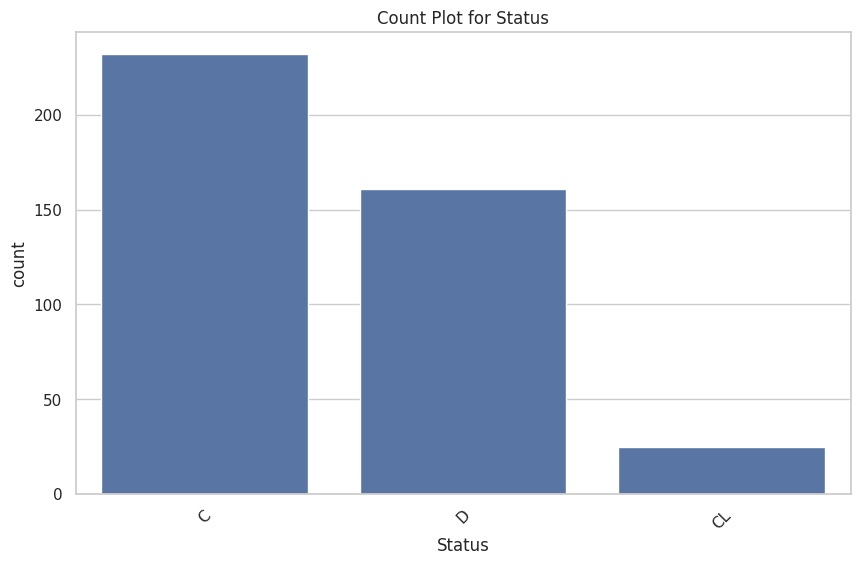

Value counts of Drug : 
D-penicillamine    158
Placebo            154
Name: Drug, dtype: int64



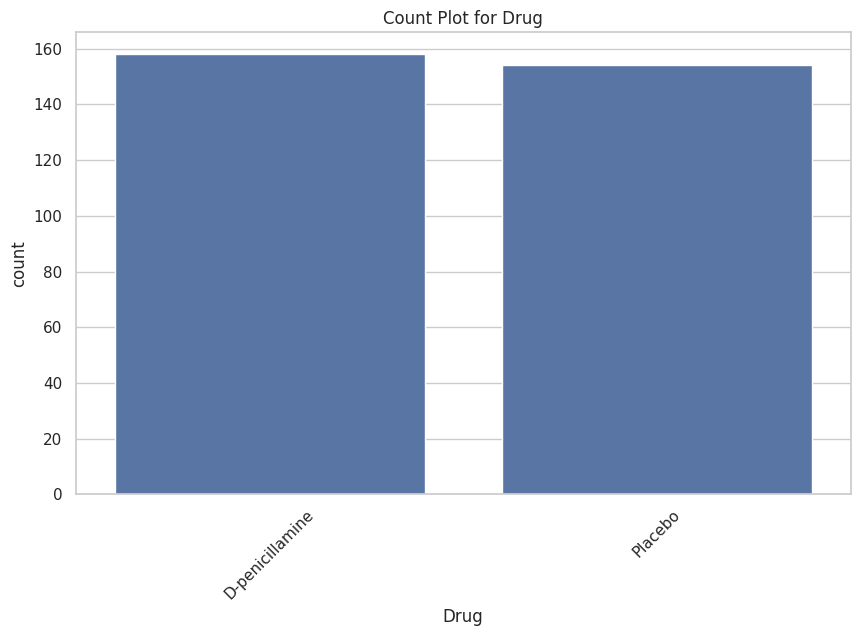

Value counts of Sex : 
F    374
M     44
Name: Sex, dtype: int64



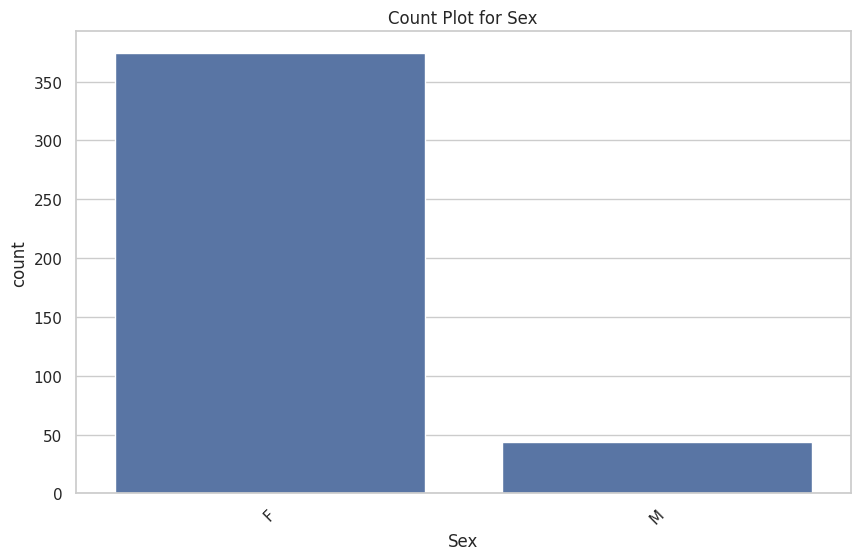

Value counts of Ascites : 
N    288
Y     24
Name: Ascites, dtype: int64



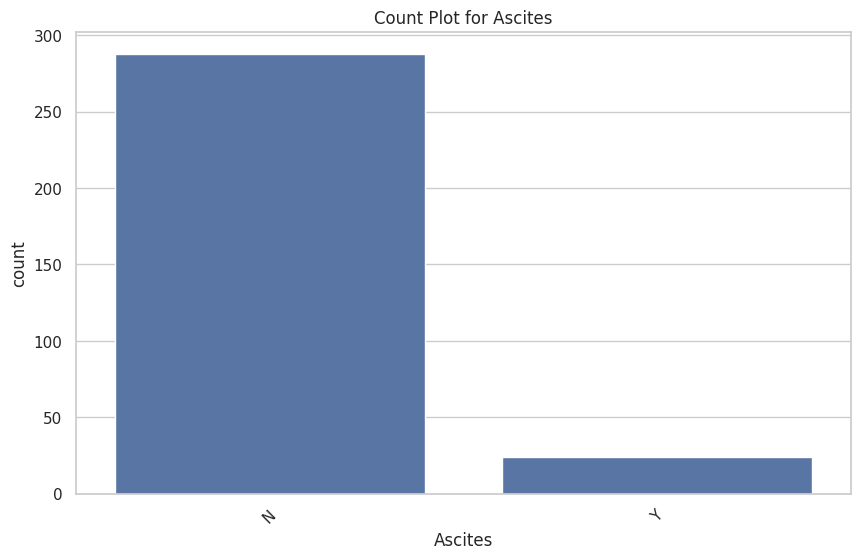

Value counts of Hepatomegaly : 
Y    160
N    152
Name: Hepatomegaly, dtype: int64



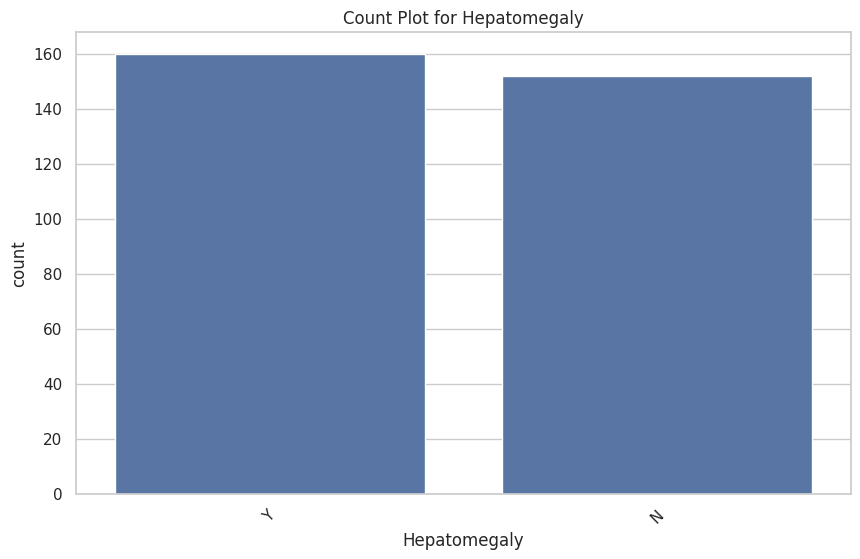

Value counts of Spiders : 
N    222
Y     90
Name: Spiders, dtype: int64



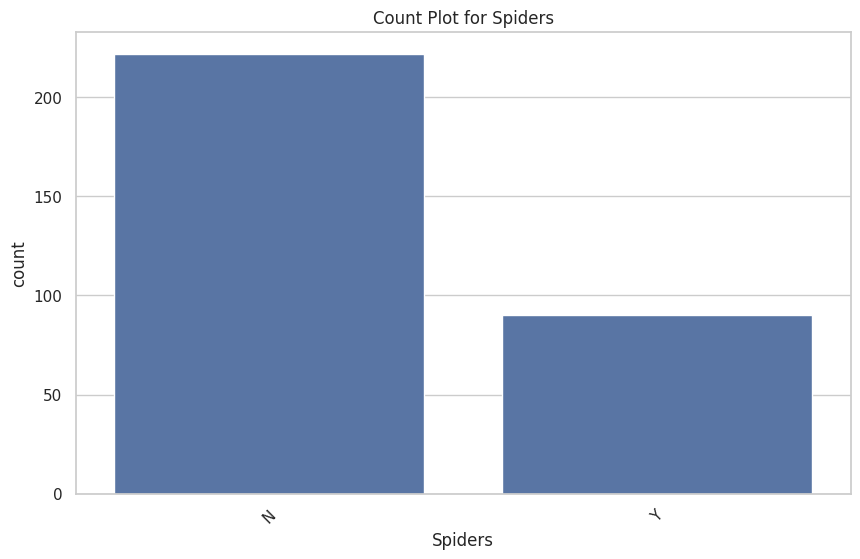

Value counts of Edema : 
N    354
S     44
Y     20
Name: Edema, dtype: int64



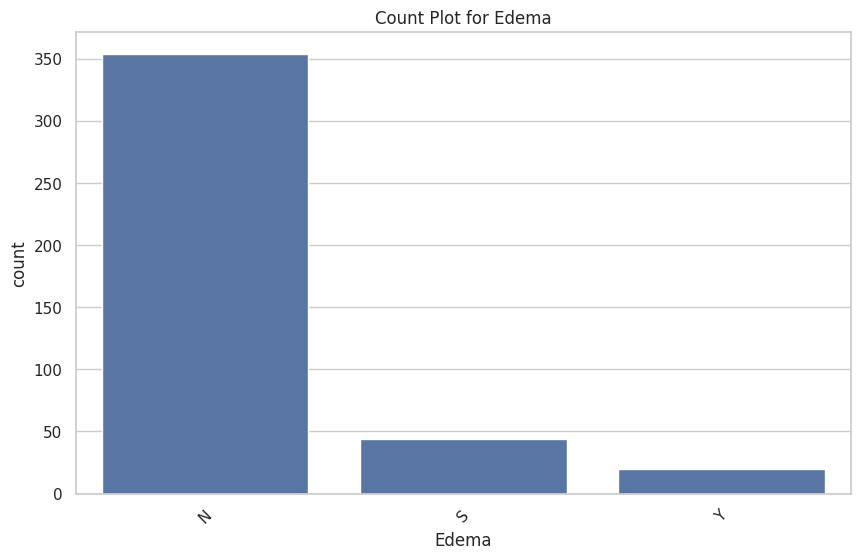

In [15]:
categorical_columns = df_data.select_dtypes(include=['object']).columns
print(categorical_columns)


# Loop through categorical columns
for column in categorical_columns:
  print(f"Value counts of {column} : \n{df_data[column].value_counts()}\n")
  # Plot count plot
  plt.figure(figsize=(10, 6))
  sns.countplot(x=column, data=df_data, order=df_data[column].value_counts().index)
  plt.title(f'Count Plot for {column}')
  plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
  plt.show()

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def analyze_numerical_columns(df):
    """
    Analyzes all numerical columns in the dataframe and prints their basic statistics.

    Args:
        df: The pandas dataframe.
    """
    # Filter numerical columns
    numerical_columns = df.select_dtypes(include=np.number).columns

    # Loop through numerical columns
    for column in numerical_columns:
        # Calculate basic statistics
        stats = df[column].describe(percentiles=[0.25, 0.5, 0.75])

        # Check for outliers using interquartile range (IQR) method
        q1, q3 = np.percentile(df[column], [25, 75])
        iqr = q3 - q1
        outlier_threshold = 1.5 * iqr
        outliers = df[(df[column] < (q1 - outlier_threshold)) | (df[column] > (q3 + outlier_threshold))]
        outlier_count = len(outliers)

        # Print statistics
        print(f"\nAnalysis of '{column}':")
        print("-" * 30)
        print(stats)
        print(f"\nNumber of outliers: {outlier_count}")

def plot_numerical_column(df, column):
    """
    Plots a histogram and a box plot for a numerical column.

    Args:
        df: The pandas dataframe.
        column: The name of the numerical column.
    """
    # Create subplots
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

    # Plot histogram
    sns.histplot(df[column], ax=axes[0], kde=True)
    axes[0].set_title(f"Histogram of '{column}'")

    # Plot box plot
    sns.boxplot(x=df[column], ax=axes[1])
    axes[1].set_title(f"Box plot of '{column}'")

    # Adjust layout
    plt.tight_layout()
    plt.show()

def analyze_and_plot_numerical_columns(df):
    """
    Analyzes and plots all numerical columns in the dataframe.

    Args:
        df: The pandas dataframe.
    """
    # Filter numerical columns
    numerical_columns = df.select_dtypes(include=[np.number]).columns

    # Loop through numerical columns
    for column in numerical_columns:
        analyze_numerical_column(df, column)
        plot_numerical_column(df, column)

In [ ]:
analyze_numerical_columns(df_data)


Analysis of 'ID':
------------------------------
count   418.00
mean    209.50
std     120.81
min       1.00
25%     105.25
50%     209.50
75%     313.75
max     418.00
Name: ID, dtype: float64

Number of outliers: 0

Analysis of 'N_Days':
------------------------------
count    418.00
mean    1917.78
std     1104.67
min       41.00
25%     1092.75
50%     1730.00
75%     2613.50
max     4795.00
Name: N_Days, dtype: float64

Number of outliers: 0

Analysis of 'Age':
------------------------------
count     418.00
mean    18533.35
std      3815.85
min      9598.00
25%     15644.50
50%     18628.00
75%     21272.50
max     28650.00
Name: Age, dtype: float64

Number of outliers: 0

Analysis of 'Bilirubin':
------------------------------
count   418.00
mean      3.22
std       4.41
min       0.30
25%       0.80
50%       1.40
75%       3.40
max      28.00
Name: Bilirubin, dtype: float64

Number of outliers: 46

Analysis of 'Cholesterol':
------------------------------
count    284.00
mean

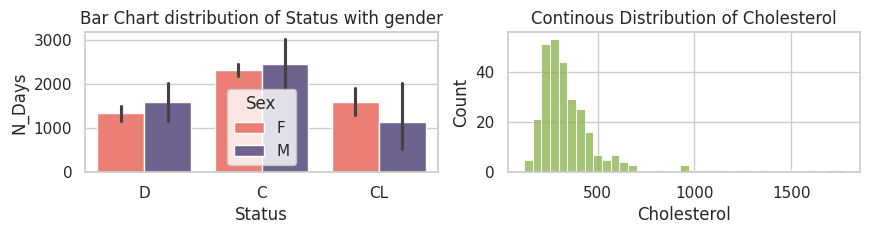

In [ ]:
custom_palette = ["#FF6F61", "#6B5B95", "#88B04B", "#F7CAC9", "#92A8D1", "#955251"]

plt.figure(figsize=(10, 10))

plt.subplot(4, 2, 1)
sns.barplot(data=df_data, x='Status', y='N_Days', hue='Sex', palette=custom_palette)
plt.title('Bar Chart distribution of Status with gender')

plt.subplot(4, 2, 2)
sns.histplot(df_data['Cholesterol'], color=custom_palette[2])  # Using a color from the palette
plt.title('Continous Distribution of Cholesterol')

plt.subplots_adjust(hspace=0.5)
plt.show()

In [ ]:
numeric = df_data.select_dtypes(include=['int64','float64'])

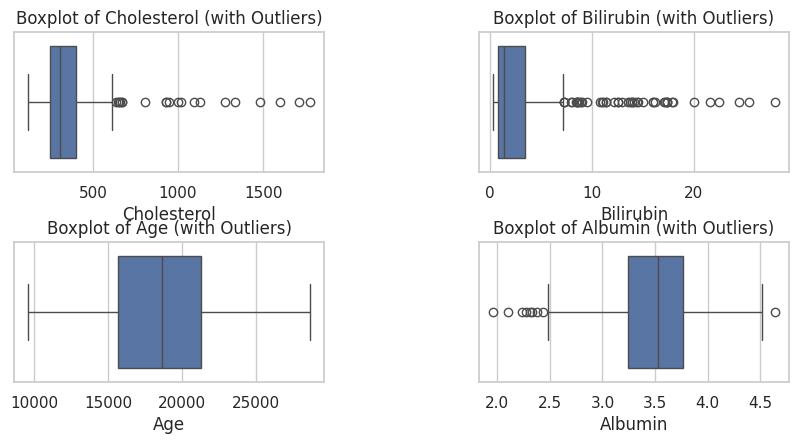

In [ ]:
plt.figure(figsize=(10,10))

plt.subplot(4,2,1)
sns.boxplot(x='Cholesterol', data=df_data, showfliers=True)
plt.title('Boxplot of Cholesterol (with Outliers)')

plt.subplot(4,2,2)
sns.boxplot(x='Bilirubin', data=df_data, showfliers=True)
plt.title('Boxplot of Bilirubin (with Outliers)')

plt.subplot(4,2,3)
sns.boxplot(x='Age', data=df_data, showfliers=True)
plt.title('Boxplot of Age (with Outliers)')

plt.subplot(4,2,4)
sns.boxplot(x='Albumin', data=df_data, showfliers=True)
plt.title('Boxplot of Albumin (with Outliers)')

plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.show()

In [ ]:
def outlier_detection(df, feature):
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    df[feature] = np.where(df[feature] < lower_bound, Q1, df[feature])
    df[feature] = np.where(df[feature] > upper_bound, Q3, df[feature])

In [ ]:
features_containing_outliers = [
    'Bilirubin', 'Cholesterol', 'Albumin',
    'Tryglicerides', 'Platelets', 'Prothrombin',
    'Copper', 'Alk_Phos','SGOT'
]

for feature in features_containing_outliers:
    outlier_detection(df_data, feature)

In [16]:
def get_features(df, feature_scaling=False):
    # Coagulation
    df['Coagulation'] = df['N_Days'] * (df['Platelets'] / (df['Prothrombin'] + 1e-9))  # Adding small value to avoid division by zero

    # Lipids
    df['Lipids'] = df['N_Days'] * (df['Cholesterol'] / (df['Tryglicerides'] + 1e-9))  # Adding small value to avoid division by zero

    # Liver
    df['Liver'] = ((df['Alk_Phos'] / (df['Prothrombin'] + 1e-9)) * (df['Albumin'] / (df['Bilirubin'] + 1e-9)))  # Adding small value to avoid division by zero

    # Blood Pressure
    df['BloodPressure'] = (df['Liver'] * df['Albumin'] * df['Prothrombin']) / (df['Platelets'] + 1e-9)  # Adding small value to avoid division by zero

    # Fats
    df['Fats'] = df['Lipids'] / (df['Tryglicerides'] + 1e-9)  # Adding small value to avoid division by zero

    # Foods
    df['Foods'] = df['Liver'] / (df['Cholesterol'] + 1e-9)  # Adding small value to avoid division by zero

    # Age in Years
    df['Age_in_years'] = df['Age']/365.0

    # Drop Age
    df.drop(columns=['Age'],axis=1,inplace = True)

    # Combination Features
    df['combination1'] = ((df['Albumin'] / (df['Bilirubin'] + 1e-9)) * (df['Platelets'] / (df['Alk_Phos'] + 1e-9)) * df['SGOT'] * df['Prothrombin'])
    df['combination2'] = ((df['Albumin'] / (df['Prothrombin'] + 1e-9)) * (df['SGOT'] / (df['Alk_Phos'] + 1e-9)) * df['Platelets'] * df['Bilirubin'])
    df['combination3'] = ((df['Cholesterol'] / (df['Copper'] + 1e-9)) * df['Tryglicerides'])  # Adding small value to avoid division by zer

    return df

In [17]:
get_features(df_data)

,ID,N_Days,Status,Drug,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Coagulation,Lipids,Liver,BloodPressure,Fats,Foods,Age_in_years,combination1,combination2,combination3
0,1,400,D,D-penicillamine,F,Y,Y,Y,Y,14.50,261.00,2.60,156.00,1718.00,137.95,172.00,190.00,12.20,4.00,6229.51,606.98,25.25,4.22,3.53,0.10,58.81,33.37,47.14,287.77
1,2,4500,C,D-penicillamine,F,N,Y,Y,N,1.10,302.00,4.14,54.00,7394.80,113.52,88.00,221.00,10.60,3.00,93820.75,15443.18,2625.60,521.37,175.49,8.69,56.48,135.35,1.46,492.15
2,3,1012,D,D-penicillamine,M,N,N,N,S,1.40,176.00,3.48,210.00,516.00,96.10,55.00,151.00,12.00,4.00,12734.33,3238.40,106.89,29.56,58.88,0.61,70.12,838.85,11.42,46.10
3,4,1925,D,D-penicillamine,F,N,Y,Y,S,1.80,244.00,2.54,64.00,6121.80,60.63,92.00,183.00,10.30,4.00,34201.46,5105.43,838.69,119.90,55.49,3.44,54.78,26.34,0.80,350.75
4,5,1504,CL,Placebo,F,N,Y,Y,N,3.40,279.00,3.53,143.00,671.00,113.15,72.00,136.00,10.90,3.00,18765.50,5828.00,63.91,18.08,80.94,0.23,38.13,259.53,25.25,140.48
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413,414,681,D,NaN,F,NaN,NaN,NaN,N,1.20,NaN,2.96,NaN,NaN,NaN,NaN,174.00,10.90,3.00,10871.01,NaN,NaN,NaN,NaN,NaN,67.05,NaN,NaN,NaN
414,415,1103,C,NaN,F,NaN,NaN,NaN,N,0.90,NaN,3.83,NaN,NaN,NaN,NaN,180.00,11.20,4.00,17726.79,NaN,NaN,NaN,NaN,NaN,39.03,NaN,NaN,NaN
415,416,1055,C,NaN,F,NaN,NaN,NaN,N,1.60,NaN,3.42,NaN,NaN,NaN,NaN,143.00,9.90,3.00,15238.89,NaN,NaN,NaN,NaN,NaN,57.04,NaN,NaN,NaN
416,417,691,C,NaN,F,NaN,NaN,NaN,N,0.80,NaN,3.75,NaN,NaN,NaN,NaN,269.00,10.40,3.00,17872.98,NaN,NaN,NaN,NaN,NaN,58.04,NaN,NaN,NaN


In [18]:
df_data.replace({'Status': {'C': 0, 'CL': 1, 'D': 2}}, inplace=True)

cat_features = df_data.select_dtypes('object').columns
num_features =  df_data.select_dtypes(exclude='object').columns
num_features = [feature for feature in num_features if feature != 'Status' and feature != 'Stage']

In [19]:
def do_log_transform(df, feature):
    df[feature] = np.log1p(df[feature])

encoder = LabelEncoder()

for feature in cat_features:
    df_data[feature] = encoder.fit_transform(df_data[feature])


for feature in num_features:
    do_log_transform(df_data, feature)

df_data.head()

,ID,N_Days,Status,Drug,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Coagulation,Lipids,Liver,BloodPressure,Fats,Foods,Age_in_years,combination1,combination2,combination3
0,0.69,5.99,2,0,0,1,1,1,2,2.74,5.57,1.28,5.06,7.45,4.93,5.15,5.25,2.58,4.00,8.74,6.41,3.27,1.65,1.51,0.09,4.09,3.54,3.87,5.67
1,1.10,8.41,0,0,0,0,1,1,0,0.74,5.71,1.64,4.01,8.91,4.74,4.49,5.40,2.45,3.00,11.45,9.64,7.87,6.26,5.17,2.27,4.05,4.92,0.90,6.20
2,1.39,6.92,2,0,1,0,0,0,1,0.88,5.18,1.50,5.35,6.25,4.58,4.03,5.02,2.56,4.00,9.45,8.08,4.68,3.42,4.09,0.47,4.26,6.73,2.52,3.85
3,1.61,7.56,2,0,0,0,1,1,1,1.03,5.50,1.26,4.17,8.72,4.12,4.53,5.21,2.42,4.00,10.44,8.54,6.73,4.79,4.03,1.49,4.02,3.31,0.59,5.86
4,1.79,7.32,1,1,0,0,1,1,0,1.48,5.63,1.51,4.97,6.51,4.74,4.29,4.92,2.48,3.00,9.84,8.67,4.17,2.95,4.41,0.21,3.67,5.56,3.27,4.95


In [26]:
feature_names=['N_Days', 'Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema',
       'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT',
       'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage', 'Coagulation',
       'Lipids', 'Liver', 'BloodPressure', 'Fats', 'Foods', 'Age_in_years',
       'combination1', 'combination2', 'combination3']

In [27]:
X = df_data.drop(['Status','ID'], axis = 1)
y = df_data['Status']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
X = df_data.drop(['Status','ID'], axis = 1)
y = df_data['Status']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
reg = LazyClassifier(verbose=0, ignore_warnings=True)
models, predictions = reg.fit(X_train, X_test, y_train, y_test)
models

 97%|█████████▋| 28/29 [00:03<00:00,  6.44it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000199 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1426
[LightGBM] [Info] Number of data points in the train set: 292, number of used features: 27
[LightGBM] [Info] Start training from score -0.564766
[LightGBM] [Info] Start training from score -2.786382
[LightGBM] [Info] Start training from score -0.994623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

100%|██████████| 29/29 [00:03<00:00,  7.82it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
BernoulliNB,0.70,0.58,None,0.70,0.03
RandomForestClassifier,0.75,0.57,None,0.74,0.36
DecisionTreeClassifier,0.68,0.57,None,0.69,0.03
LGBMClassifier,0.74,0.56,None,0.73,0.25
LinearSVC,0.80,0.56,None,0.78,0.13
RidgeClassifier,0.80,0.56,None,0.77,0.03
NearestCentroid,0.60,0.55,None,0.66,0.02
Perceptron,0.75,0.55,None,0.73,0.03
LogisticRegression,0.79,0.55,None,0.77,0.07


In [29]:
from sklearn.svm import LinearSVC
from sklearn.impute import SimpleImputer

# Initialize the imputer
imputer = SimpleImputer(strategy='mean')

# Fit and transform the training data
X_train_imputed = imputer.fit_transform(X_train)

# Transform the testing data
X_test_imputed = imputer.transform(X_test)


# Initialize LinearSVC Classifier
linear_svc = LinearSVC()
# Train the classifier
linear_svc.fit(X_train_imputed, y_train)

# Make predictions
y_pred = linear_svc.predict(X_test_imputed)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)


Accuracy: 0.7777777777777778


In [55]:
logistic_regression = LogisticRegression()

X_train_imputed=pd.DataFrame(X_train_imputed, columns=feature_names)
X_test_imputed=pd.DataFrame(X_test_imputed, columns=feature_names)
# Train the classifier
logistic_regression.fit(X_train_imputed, y_train)

# Make predictions
y_pred = logistic_regression.predict(X_test_imputed)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.7777777777777778


In [ ]:
xgb_classifier = XGBClassifier()

# Train the classifier
xgb_classifier.fit(X_train, y_train)

# Make predictions
y_pred = xgb_classifier.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.746031746031746


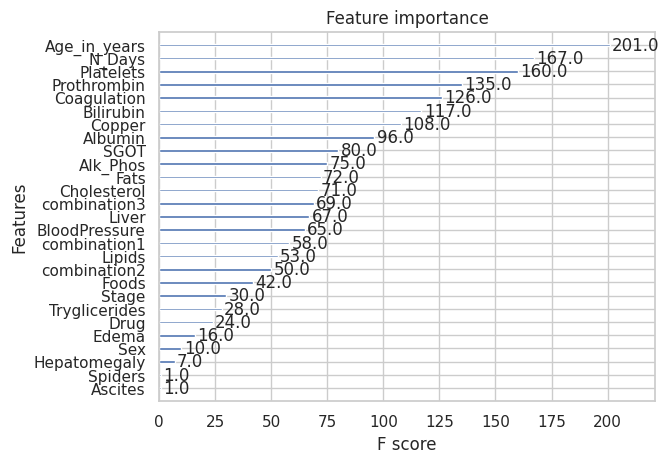

In [ ]:
xgb.plot_importance(xgb_classifier)
plt.show()

In [33]:
X_explain = X_train_imputed[:100]

In [34]:
# Initialize the SHAP explainer
explainer = shap.KernelExplainer(logistic_regression.predict, X_explain)

In [35]:
# Calculate SHAP values
shap_values = explainer.shap_values(X_explain)


  0%|          | 0/100 [00:00<?, ?it/s]

In [36]:
print(X_train.columns)

Index(['N_Days', 'Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema',
       'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT',
       'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage', 'Coagulation',
       'Lipids', 'Liver', 'BloodPressure', 'Fats', 'Foods', 'Age_in_years',
       'combination1', 'combination2', 'combination3'],
      dtype='object')


In [37]:
columns = ['N_Days', 'Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema',
       'Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT',
       'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage', 'Coagulation',
       'Lipids', 'Liver', 'BloodPressure', 'Fats', 'Foods', 'Age_in_years',
       'combination1', 'combination2', 'combination3','ID']

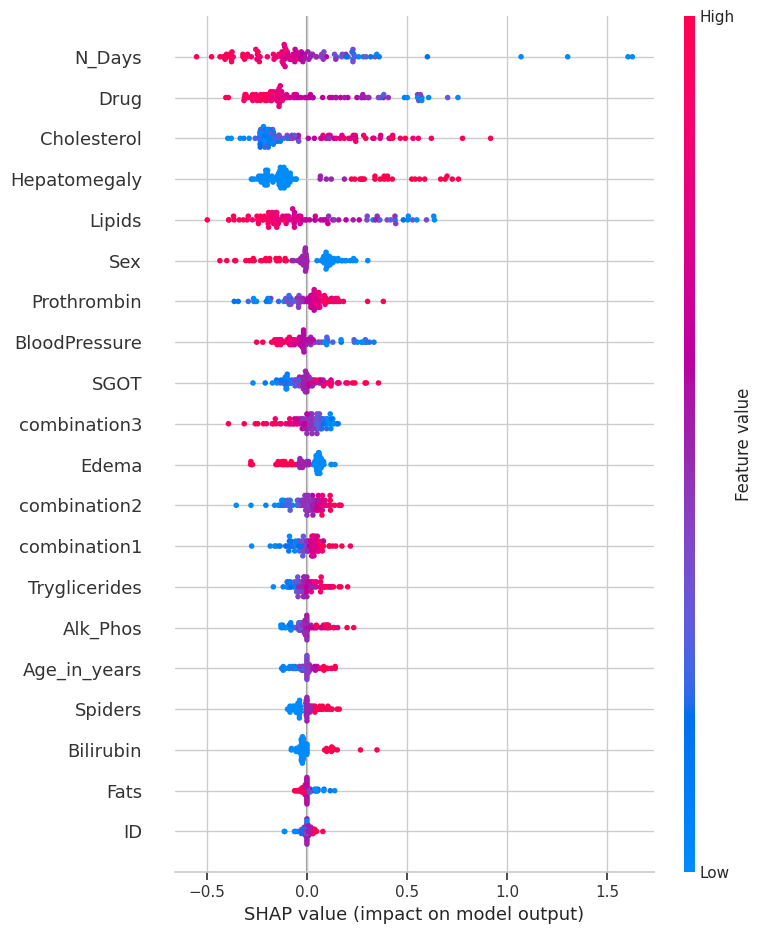

In [ ]:
# Plot the SHAP values
shap.summary_plot(shap_values, X_explain, feature_names=columns)

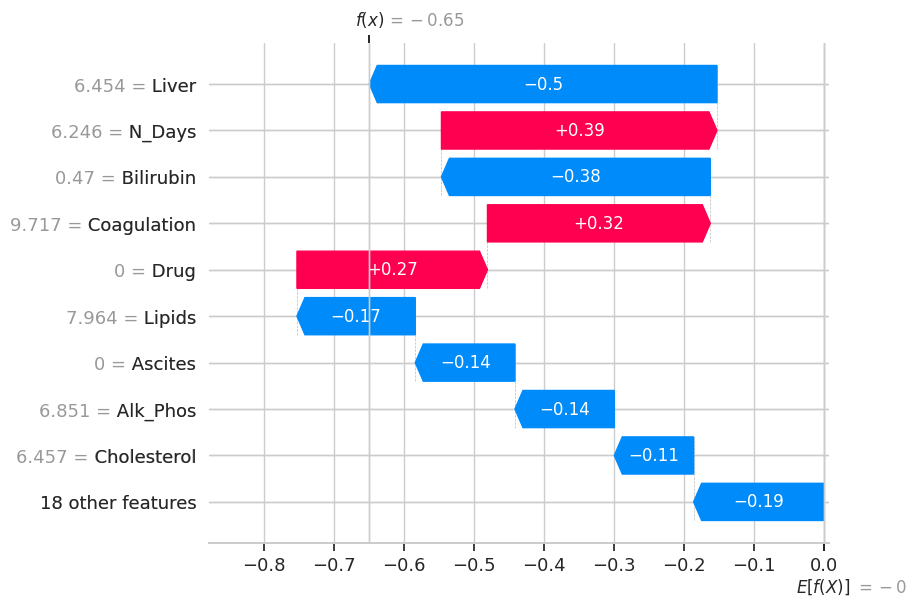

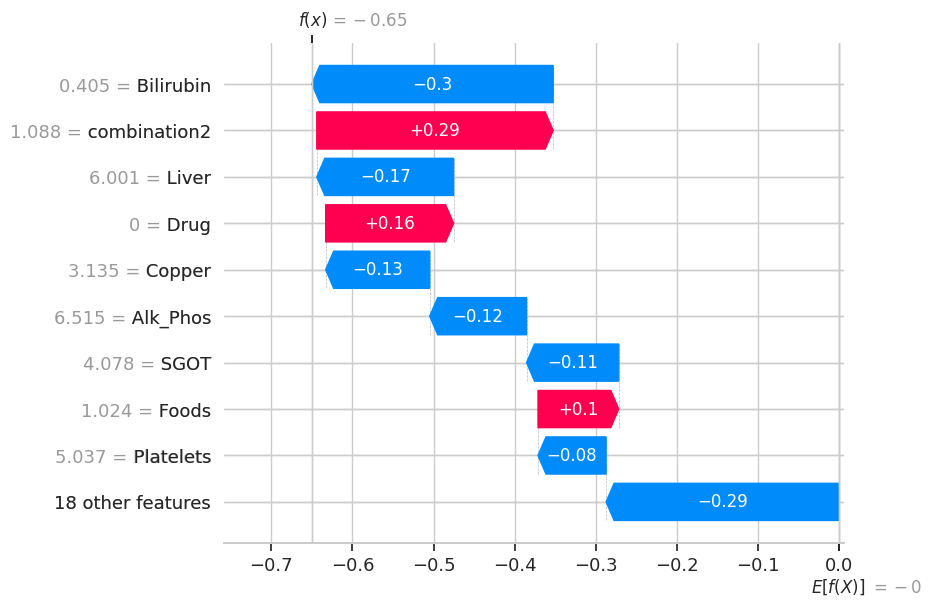

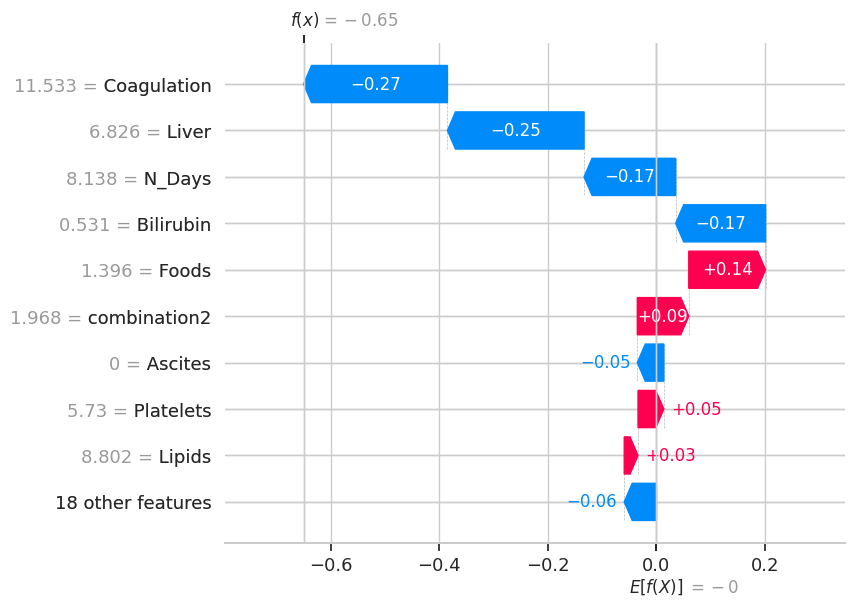

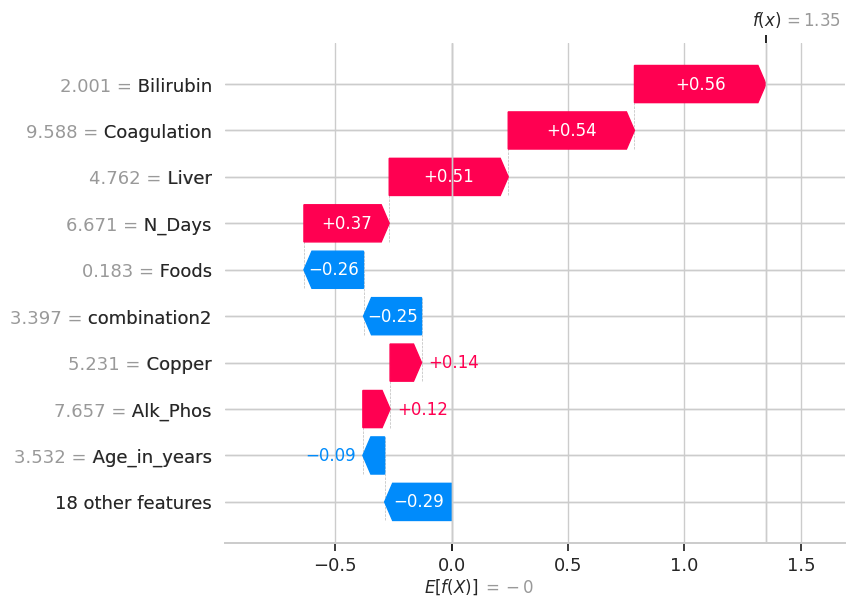

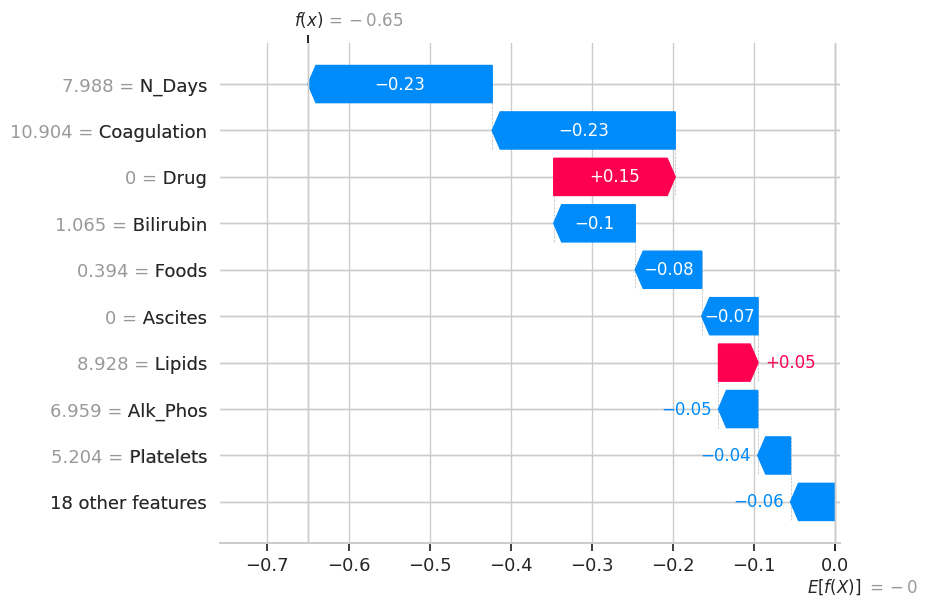

...

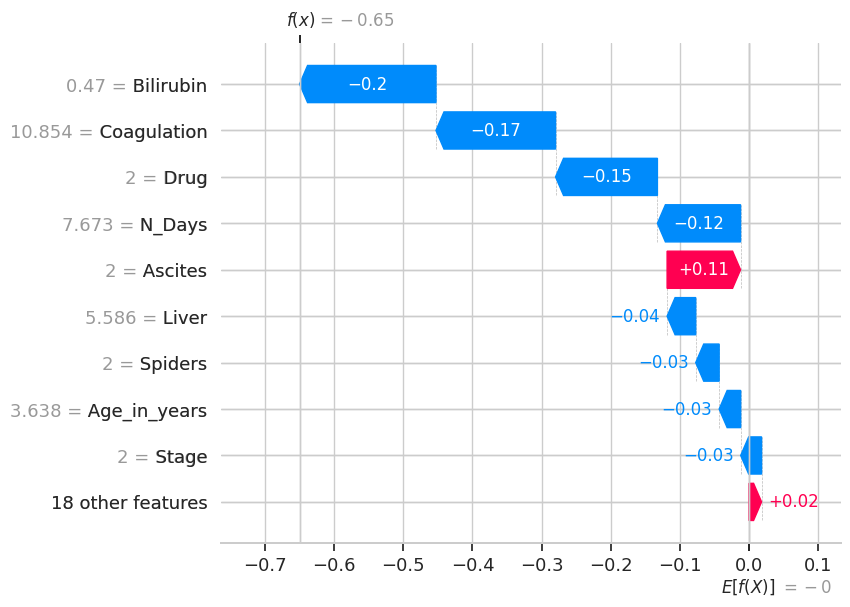

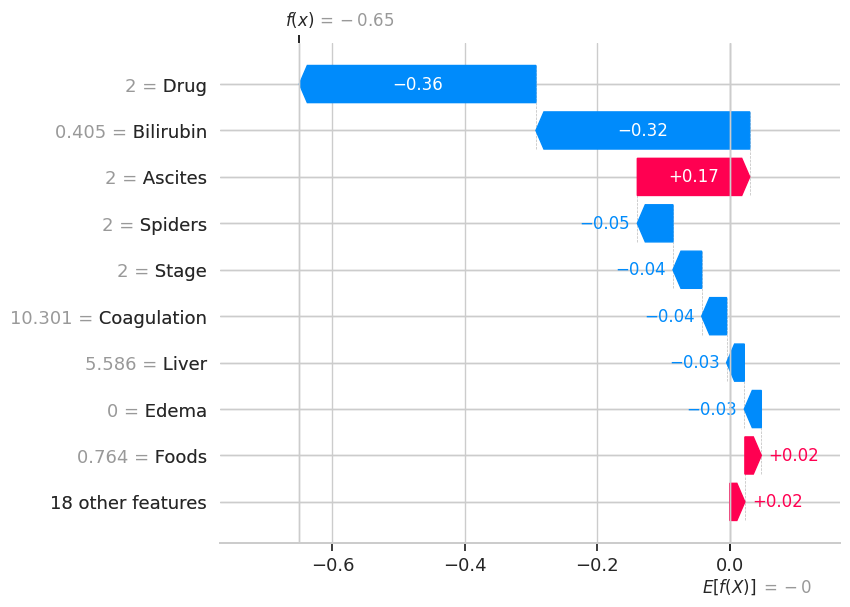

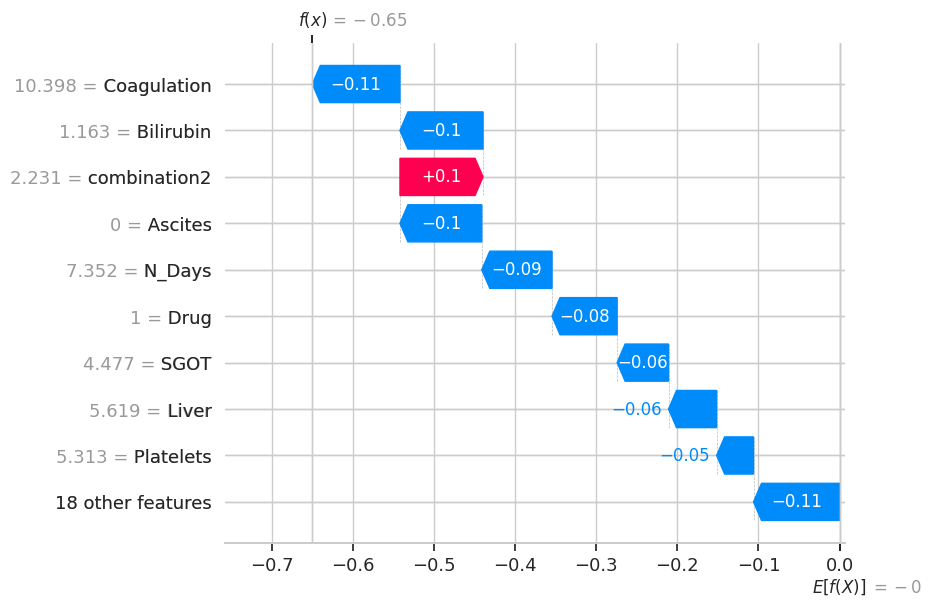

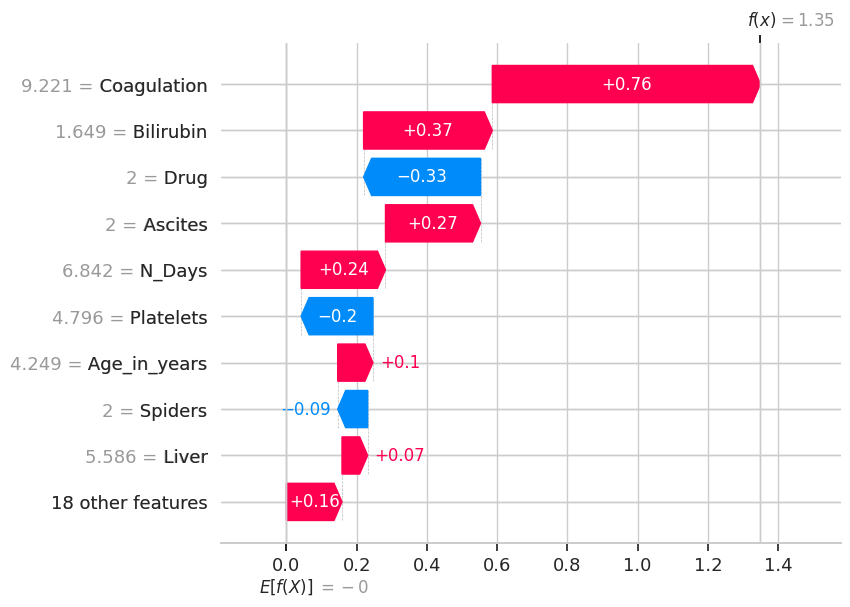

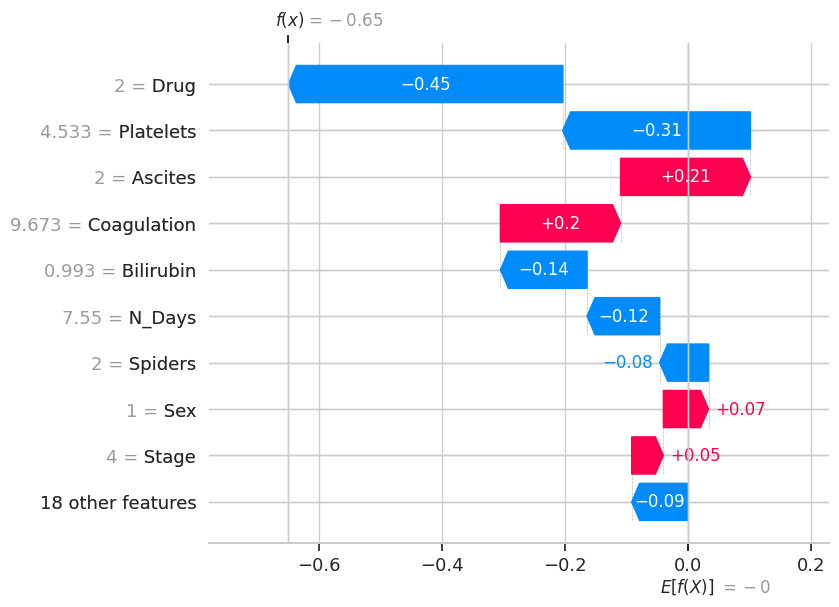

<Figure size 640x480 with 0 Axes>

In [38]:
import matplotlib.pyplot as plt

# Number of instances to explain
num_instances = 12

plt.figure(figsize=(40, 10))
# Loop through each instance
for i in range(num_instances):
    # Create an Explanation object
    expl = shap.Explanation(values=shap_values[i],
                            data=X_explain.iloc[i],
                            feature_names=columns)

    # Set base_values attribute
    expl.base_values = np.mean(shap_values)
    # Plot the waterfall plot
    shap.plots.waterfall(expl)

plt.tight_layout()
plt.show()



In [ ]:
expected_value = explainer.expected_value

# Plot the force plot
shap.plots.force(expected_value, shap_values)

In [56]:
# Importing the module for LimeTabularExplainer
from lime import lime_tabular

# Instantiating the explainer object by passing in the training set,
# and the extracted features
# Convert the NumPy array X_train to a DataFrame
X_train_df = pd.DataFrame(X_train, columns=feature_names)

X_train_df.reset_index(drop=True, inplace=True)

# Make sure that the feature names (col) match the columns of your DataFrame
col = X_train_df.columns.tolist()

# Instantiate the explainer object by passing in the DataFrame
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_imputed.values,
                                                   feature_names=feature_names,
                                                   class_names=["0","1","2"],
                                                   mode='classification')




In [57]:
import matplotlib.pyplot as plt

# Number of instances to explain
num_instances = 12


# Loop through each instance
for i in range(num_instances):
    # Choose a specific instance
    instance = X_test_imputed.iloc[i]

    # Explain the prediction for the instance
    explanation = explainer.explain_instance(instance, logistic_regression.predict_proba)

    # Plot the explanation in the corresponding subplot
    explanation.show_in_notebook()



In [58]:
explainer = dx.Explainer(logistic_regression, X_train, y_train, label="Logistic Regression")

Preparation of a new explainer is initiated

  -> data              : 292 rows 27 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 292 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Logistic Regression
  -> predict function  : <function yhat_proba_default at 0x7cfc53a2d870> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.00016, mean = 0.0618, max = 0.691
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.235, mean = 0.74, max = 2.0
  -> model_info        : package sklearn

A new explainer has been created!


In [59]:
fi = explainer.model_parts().plot()

In [60]:
num_instances = 12


# Loop through each instance
for i in range(num_instances):
    # Choose a specific instance
    instance = X_test.iloc[0, :]

    # Explain the prediction for the instance
    pp = explainer.predict_parts(instance).plot()


In [61]:
mp = explainer.model_performance().result

In [62]:
pd_plot = explainer.model_profile(variables=["Albumin"])

# Plot partial dependence plot
pd_plot.plot()

Calculating ceteris paribus: 100%|██████████| 1/1 [00:00<00:00, 13.15it/s]


In [63]:
pdp_num = explainer.model_profile(type = 'partial', label="pdp")

Calculating ceteris paribus: 100%|██████████| 27/27 [00:01<00:00, 13.86it/s]


In [64]:
ale_num = explainer.model_profile(type = 'accumulated', label="ale")

Calculating accumulated dependency: 100%|██████████| 27/27 [00:06<00:00,  4.12it/s]


In [65]:
pdp_num.plot(ale_num)